Author: Ryan Timbrook (RTIMBROO)  
DATE: 12/3/2019 <br>
Topic: 

## 1. Objective:
-----------------------------------------------------------------------------------------------------

In [1]:
import pandas as pd
import numpy as np
import json
import os
from os import path
import fnmatch
import io
import re
import string
from datetime import date
from datetime import time
from datetime import datetime

import seaborn as sns
import matplotlib.pyplot as plt #2D plotting
%matplotlib inline
#
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

In [2]:
# custome python packages
import rtimbroo_utils as br  

In [3]:
# set global properties
notebook_file_name = 'classify_train_nfl_master'
report_file_name = 'classify_train_nfl_master'
app_name = 'classify_train_nfl_master'
log_level = 10 # 10-DEBUG, 20-INFO, 30-WARNING, 40-ERROR, 50-CRITICAL

# setup working directory structure
# set global properties
dataDir = './data/train'
logOutDir = './logs'
imageDir = './images'
outputDir = './output'

# create base output directories if they don't exist
if not os.path.exists(logOutDir): os.mkdir(logOutDir)
if not os.path.exists(imageDir): os.mkdir(imageDir)
if not os.path.exists(dataDir): os.mkdir(dataDir)
if not os.path.exists(outputDir): os.mkdir(outputDir)

In [4]:
# get a logger for troubleshooting / data exploration
logger = br.getFileLogger(logOutDir+'/',app_name,level=log_level)

In [5]:
#train_nfl_master = pd.read_csv(f'{dataDir}/train_nfl_master.csv', encoding='latin')

# the nfl_master2_df is a copy of the nfl_tweets_master.csv created from the 'merge_datasets_to_master' notebook
# it's attributes have been reduced to just the 'id' and 'text' fields for classification
train_nfl_master = pd.read_csv(f'{dataDir}/nfl_master2_df.csv', encoding='latin')

In [6]:
logger.info(f'{train_nfl_master.shape}')
train_nfl_master.head()

(10148, 2)


,id,text
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...
2,1170439772814422016,I got Lj and deshaun watson.... I been think...
3,1172871878538596352,RT How do I inquire about a trade with the Tex...
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...


# 1. Perform Sentiment Intensity Analysis
----------------------------------------------------------------------------------------------
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

VADER Sentiment Analysis. VADER (Valence Aware Dictionary and sEntiment Reasoner) is a lexicon and rule-based sentiment analysis tool that is specifically attuned to sentiments expressed in social media, and works well on texts from other domains.

## Functions

In [7]:
def classify_vader_score_threshold(compound_score):
    pos_sent = 'positive'
    neu_sent = 'neutral'
    neg_sent = 'negative'
    sentiment_class = ''
    
    if compound_score >= 0.05:
        sentiment_class = pos_sent;
    elif compound_score > -0.05 and compound_score < 0.05:
        sentiment_class = neu_sent;
    elif compound_score <= -0.05:
        sentiment_class = neg_sent;
    else:
        logger.warning(f'classify_vader_score_threshold: compound score not in range: {compound_score}')
    return sentiment_class


Vader Sentiment Analysis Resources:
* [Using VADER to handle sentiment analysis with social media text](http://t-redactyl.io/blog/2017/04/using-vader-to-handle-sentiment-analysis-with-social-media-text.html)
* [Github - cjhutto](https://github.com/cjhutto/vaderSentiment)

## 1.1 Sentiment Classification - Uncleansed Tweet Text

In [8]:
analyzer = SentimentIntensityAnalyzer()
pol_scores=[]
pol_text=[]
pol_text_id=[]

with io.open(f'{outputDir}/vader_tweet_sentiment.txt','w+',encoding='latin') as f:
    for index, row in train_nfl_master.iterrows():
        try:
            vs = analyzer.polarity_scores(row['text'])
            pol_scores.append(vs)
            pol_text.append(row['text'])
            pol_text_id.append(row['id'])
            f.write("{:-<65} {}".format(row['text'], str(vs))+'\n')
            logger.debug("{:-<65} {}".format(row['text'], str(vs)))
        
        except BaseException as be:
            logger.warning(f'***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: {be}')

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 137: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 70: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 45: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 201: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 137: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 56: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 61: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 123: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 54: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9d' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 112: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 163: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 163: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT Pep breaks down how Deshaun Watson is a dual-threat QB and ways the defense can take him down Sunday Ã°Â\x9fÂ\x92Âª {'neg': 0.0, 'neu': 0.927,

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 55: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 155: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 57: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x81' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 85: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 126: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 81: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 98: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 170: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9c' in position 159: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "1)Tom Brady - Patriots 2) Pat Mahomes - Chiefs 3) Aaron Rodgers - Packers 4) Phillip Rivers - Chargers 5) Russell WÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 117: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 78: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 68: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "On the eve of tomorrowÃ¢Â\x80Â\x99s game between the Ravens and Texans, letÃ¢Â\x80Â\x99s take a look at the first time Lamar Jackson andÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_enco

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 159: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

Message: "RT Ppl talked about Mahomes vs Lamar as the future. No ... the future of the AFC is this matchup. Pat Mahomes vs Deshaun WaÃ¢Â\x80Â¦ {'neg': 0.084, 'neu': 0.916, 'pos': 0.0, 'compound': -0.296}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9d' in position 282: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "It is elementary. Ã°Â\x9fÂ\x8fÂ´Ã¢Â\x80Â\x8dÃ¢Â\x98Â\xa0Ã¯Â¸Â\x8fÃ°Â\x9fÂ\x8fÂ\x88Ã°Â\x9fÂ§Â\x90  The Raiders must put constant pressure versus Watson. Deshaun has been sacked 21 times in 7 games, ranked 25th. {'neg': 0.091, 'neu': 0.909, 'pos': 0.0, 'compound': -0.296}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 262: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anac

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 181: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 262: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 306: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 100: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 112: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 182: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT Deshaun Watson has SCARY good accuracy Ã°Â\x9fÂ\x8eÂ¯https://t.co/9Mf3Jlms1v {'neg': 0.306, 'neu': 0.468, 'pos': 0.226, 'compound': -0.2577}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 67: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 249: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 147: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 201: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 134: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 161: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 163: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 48: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.p

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 53: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 256: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 160: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 134: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 140: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT The only NFL team Antonio Brown follows on Instagram is the Houston Texans Ã°Â\x9fÂ¤Â\x94 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 143: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã°Â\x9fÂ\x8fÂ\x88 Sept. 28, 2014: J.J. Watt scores on an 80-yard INT return, and Darryl Morris' late INT seals a 23-17 Houston Texans win over th

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 165: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 137: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The Jaguars and Texans Sunday in London. Most teams try to stop the run. Feels like against Houston if you contain Hopkins that is the key. Now on hang tight on the video feed. Working on it. Ã°Â\x9fÂ\x91Â\x8a  {'neg': 0.054, 'neu': 0.885, 'pos': 0.061, 'compound': 0.0772}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 101: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\A

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã°Â\x9fÂ\x9aÂ¨New Podcast!Ã°Â\x9fÂ\x9aÂ¨@TheTexansWireÃ¢Â\x80Â\x99s joins me to discuss all things Texans!  Ã°Â\x9fÂ\x91Â\x89Give the O-line a break Ã°Â\x9fÂ\x91Â\x89ShoÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 105: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 226: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Hey Texans, come join   October 29: Cleveland, Tx  October 30: Houston, Tx  October 31: Conroe, Tx  Details:  All Patriots welcome! Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸ {'neg': 0.0, 'neu': 0.552, 'pos': 0.448, 'compound': 0.8999}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x81' in position 177: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 147: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "2 tickets to NFL 2019 London Games - Houston Texans at Jacksonville Jaguars at Wembley Stadium - Wembley, 03 Nov, fÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 85: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 119: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Imagine if Texas was still seceded from the union. All the Texans would have to provide visas or passports to comeÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__i

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 129: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 122: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 54: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 253: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Sorry! Not a native Texan, but was privileged to live north of Houston 11 years. DidÃ¢Â\x80Â¦ {'neg': 0.063, 'neu': 0.711, 'pos': 0.226, 'compound': 0.6114}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Pyth

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 112: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.p

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 116: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 77: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Insane. Impossible. DoesnÃ¢Â\x80Â\x99t stand a chance. Here we go...  Ã¢Â\x80Â¢ 465 Houston Texans +200 Ã¢Â\x80Â¢ 457 Jacksonville Jaguars +125 Ã¢Â\x80Â¢ 476 LA Chargers +186 Ã¢Â\x80Â¢ 457 Jacksonville/Indy u21 1H  Risk: $100   To Win: $3669.07  TheCollegeKids Ã°Â\x9fÂ\x93Â\x9aÃ¢Â\x9cÂ\x8fÃ¯Â¸Â\x8f {'neg': 0.115, 'neu': 0.745, 'pos': 0.139, 'compound': 0.25}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.p

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 126: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 125: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "O confronto entre os Houston Texas e os Kansas City Chiefs pode ser espectacular se pensarmos nas capacidades de DeÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\An

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 85: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 142: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "1 ticket to NFL 2019 London Games - Houston Texans at Jacksonville Jaguars at Wembley Stadium - Wembley, 03 Nov, leÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã°Â\x9fÂ\x9aÂ\x80HOUSTON DÃ\x83Â\x89BARQUE POUR LA 7e DES 10MaillotsEn10Jours !! Ã°Â\x9fÂ\x8eÂ\x81  Ã°Â\x9fÂ\x8fÂ\x80 Harden et Russ' vont pas beaucoup lÃ\x83Â¢cher la gonfle cette saison mais nous on vous lÃ\x83Â¢che le maillot des Texans !   Ã¢Â\x9eÂ¡ RT + Follow &amp; pour participer {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    st

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 144: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Do you need to speak with Houston Texas Criminal Lawyer? |   Drug Attorney  | DWI  |Ã¢Â\x80Â¦ {'neg': 0.207, 'neu': 0.793, 'pos': 0.0, 'compound': -0.5267}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_mo

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 80: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 100: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 155: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 50: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 99: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 137: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 154: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "While the signing of Allen Bailey mitigated the risk to a degree, there's no reason John Cominsky should've been drÃ¢Â\x80Â¦ {'neg': 0.202, 'neu'

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 134: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 307: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 53: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Message: "RT The only NFL team Antonio Brown follows on Instagram is the Houston Texans Ã°Â\x9fÂ¤Â\x94 {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x96' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 139: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 101: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 156: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 133: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 63: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 123: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 119: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 188: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Hey Texans, come join   October 29: Cleveland, Tx  October 30: Houston, Tx  October 31: Conroe, Tx  Details:  All Patriots welcome! Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸ {'neg': 0.0, 'neu': 0.552, 'pos': 0.448, 'compound': 0.8999}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 90: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x8f' in position 62: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 147: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 156: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 103: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Bless u brothaÃ°Â\x9fÂ\x99Â\x8fÃ°Â\x9fÂ\x8fÂ¼----------------------------------- {'neg': 0.0, 'neu': 0.263, 'pos': 0.737, 'compound': 0.4215}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    st

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 142: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 149: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9a' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Hundreds of people gathered in Katy early this morning to raise awareness and funds for Alzheimer's care, support and research. Currently, more than 380,000 Texans are living with AlzheimerÃ¢Â\x80Â\x99s disease. HOW YOU CAN HELP: {'neg': 0.0, 'neu': 0.769, 'pos': 0.231, 'compound': 0.8531}"
Argume

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 299: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 97: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 47: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Just landed in Houston. Jaguars rule out cornerback A.J. Bouye (hip) and receiver Marqise Lee (knee) for tomorrowÃ¢Â\x80Â\x99s game with Texans. They join Ngakoue, Ogbuehi and Oliver as out, with Foles already on IR. Brutal attrition. {'neg': 0.102, 'neu': 0.844, 'pos': 0.055, 'compound': -0.4404}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode c

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Player impact: reports that the publicÃ¢Â\x80Â\x99s generous donations after Hurricane Harvey have helpÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.784, 'pos': 0.216, 'compound': 0.5106}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init_

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.p

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 94: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 193: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x81' in position 147: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "secondary coach on the Houston Texans for three seasons) and Gary Kubiak (who was head coach when the Texans drafteÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 99: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 98: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT The Houston Texans signed free agent QB Alex McGough to the practice squad and released TE Keenen Brown from the practice sqÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.87, 'pos': 0.13, 'compound': 0.5106}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(i

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 122: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 67: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Texans Club Championship Ã¢Â\x8fÂ° Today 3pm ET Ã°Â\x9fÂ\x93Â\x8d Houston, TX (NRG Stadium) Ã°Â\x9fÂ\x93Âº WeAreTexans  MaddenClubChampionship {'neg': 0.0, 'neu': 0.679, 'pos': 0.321, 'compound': 0.7297}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 131: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 53: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 119: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã¢Â\x80Â\x98Thursday Night FootballÃ¢Â\x80Â\x99 Ratings Tackled To Season Low, Ã¢Â\x80Â\x98GreyÃ¢Â\x80Â\x99s AnatomyÃ¢Â\x80Â\x99 Midseason FinaleÃ\x82Â\xa0Ã¢Â\x80Â¦ {'neg': 0.149, 'neu': 0.851, 'pos': 0.0, 'compound': -0.2732}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 131: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "ChiefsÃ¢Â\x80Â\x99 defenders make stopping the run a Ã¢Â\x80Â\x98first priorityÃ¢Â\x80Â\x99 against Houston Texans {'neg': 0.134, 'neu': 0.756, 'pos': 0.109, 'compound': -0.0772}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt31

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: " No Texas shows? I would totally suggest the Austin area if you were to only pick one metroplex buÃ¢Â\x80Â¦ {'neg': 0.115, 'neu': 0.885, 'pos': 0.0, 'compound': -0.296}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 139: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 66: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 130: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 62: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "IÃ¢Â\x80Â\x99m out here at Texans practice at Hazelwood, and both Laremy Tunsil (shoulder), who was limited yesterday, and Tytus Howard (knee), who was a full participant Thursday, are practicing. Having them both on Sunday is a huge difference maker for Houston and Deshaun Watson. {'neg': 0.043, 'neu': 0.905, 'pos': 0.052, 'compound': 0.1027}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 103: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 133: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 59: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    h

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "watching your show and seeing the Trent Williams situation reminds me how the HÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeErro

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 162: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Working on the website,. Getting ready to launch the site with updates on all our recent projects. Cant wait to shaÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.889, 'pos': 0.111, 'compound': 0.3612}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 98: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: 'Ã°Â\x9fÂ\x93Â» Ã°Â\x9fÂ\x8fÂ\x88 JJ Watt (Houston Texans) "If I want to watch beautiful, flowing football, I\'ll watch Messi. If I wanna watch so

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 132: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 99: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
   

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 165: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "thinks Mike Mayock should dump the Oakland Raiders and try to get the GM job that is currently (paiÃ¢Â\x80Â¦ {'neg': 0.126, 'neu': 0.874, 'pos': 0.0, 'compound': -0.3818}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 75: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 93: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 307: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 164: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 160: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Carlos Correa (@TeamCJCorrea) was thrilled to see Texans players wearing Astros jerseys on their way to Indy to play the Colts: Ã¢Â\x80Â\x9cThat 

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 269: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The devastation and flooding from Imelda is heartbreaking. But in times like these, Texans are strong and we willÃ¢Â\x80Â¦ {'neg': 0.147, 'neu': 0.564, 'pos': 0.289, 'compound': 0.7003}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Use

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 148: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 144: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 81: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "O 027 comentou o desempenho do Texans no Monday Night Football vs e as trocas que chÃ¢Â\x80Â¦ {'neg': 0.145, 'neu': 0.855, 'pos': 0.0, 'compound': -0.296}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
Unico

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Congratulations to the 2019 Texans CampeÃ\x83Â³n de la Comunidad Award winner, Sonia Corrales, Chief Program Officer of the Houston Area Women's Center!  Ã°Â\x9fÂ\x93Â° Ã\x82Â»  | TexansCare {'neg': 0.0, 'neu': 0.657, 'pos': 0.343, 'compound': 0.9098}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 126: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 104: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 131: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 100: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Carlos Correa (@TeamCJCorrea) was thrilled to see Texans players wearing Astros jerseys on their way to Indy to play the Colts: Ã¢Â\x80Â\x9cThat 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 148: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 74: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "DARYL MOREY: I spoke out against an authoritarian regime and still might lose my job.  JEFF LUHNOW: I reaped the rewards of trading for an abuser, took part in a coverup and smeared a reporter, and I got away with firing my subordinate.  HOUSTON TEXANS GM: I donÃ¢Â\x80Â\x99t exist! {'neg': 0.176, 'neu': 0.763, 'pos': 0.061, 'compound': -0.7088}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, i

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
   

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã°Â\x9fÂ\x9aÂ\x80HOUSTON DÃ\x83Â\x89BARQUE POUR LA 7e DES 10MaillotsEn10Jours !! Ã°Â\x9fÂ\x8eÂ\x81  Ã°Â\x9fÂ\x8fÂ\x80 Harden et Russ' vont pas beaucoup lÃ\x83Â¢cher la gonfle cette saison mais nous on vous lÃ\x83Â¢che le maillot des Texans !   Ã¢Â\x9eÂ¡ RT + Follow &amp; pour participer {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
Unicode

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 139: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 139: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 97: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Les Colts, adversaire de division des Texans, ont rÃ\x83Â©ussi Ã\x83Â\xa0 stopper Mahomes et les Chiefs la semaine passÃ\x83Â©e. Est-ceÃ¢Â\x80Â¦ 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 134: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 45: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 126: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 121: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Hey Texans, come join   October 29: Cleveland, Tx  October 30: Houston, Tx  October 31: Conroe, Tx  Details:  All Patriots welcome! Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸ {'neg': 0.0, 'neu': 0.552, 'pos': 0.448, 'compound': 0.8999}"
Arguments: ()
***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 233: character maps to <undefined>
Call st

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 156: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 269: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "4 tickets to NFL 2019 London Games - Houston Texans at Jacksonville Jaguars at Wembley Stadium - Wembley, 03 Nov, lÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt31

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 110: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 86: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Ã°Â\x9fÂ\x98Â¬.  Houston Texans 2019 season preview: Bill O'Brien all-in to protect Deshaun Watson {'neg': 0.0, 'neu': 0.822, 'pos': 0.178, 'compound': 0.3818}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 155: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 76: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 59: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    h

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 49: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Message: "RT NEW BLOG POST Ã¢Â\x80Â\x94 Five OÃ¢Â\x80Â\x99Brien Era Decisions the Houston Texans Would Like BackÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.848, 'pos': 0.152, 'compound': 0.3612}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 58: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The reputation of Bill O'Brien and the Houston Texans is being laughed at and mocked. The decisions invited reasonaÃ¢Â\x80Â¦ {'neg': 0.103, 'neu': 0.762, 'pos': 0.135, 'compound': 0.1779}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\l

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 76: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 155: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Message: '9.2 MMQB is up! On a wild weekend ...  Ã°Â\x9fÂ\x92Â¥ Houston\'s O\'Brien: Ã¢Â\x80Â\x9cWe\'re trying to get better in all ways. The roster is just one way to do that." Ã°Â\x9fÂ\x92Â¥ Seattle\'s Schneider: "He can do whatever he wants to do when he wants to do it." Ã°Â\x9fÂ\x92Â¥ Flores\' task.  And MORE! {\'neg\': 0.0, \'neu\': 0.934, \'pos\': 0.066, \'compound\': 0.5399}'
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 76: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py"

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The Texans had quite the day on Saturday, trading away Clowney and trading for Laremy Tunsil and Kenny Stills. Now weÃ¢Â\x80Â\x99re left askingÃ¢Â\x80Â¦ whatÃ¢Â\x80Â\x99s the direction for this franchise? {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: characte

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 143: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 160: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "A NFL team I love: Browns A NFL team I like: Panthers A NFL team I dislike: 49ers A NFL team I hate: Steelers A NFLÃ¢Â\x80Â¦ {'neg': 0.242, 'neu': 0.5, 'pos': 0.258, 'compound': 0.1027}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\r

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 232: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 111: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "KJ has great potential. But he is not the second coming of DeShaun Watson has some have made him out toÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.887, 'pos'

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 61: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The Prodigy says to spend big &amp; stack the lethal combo of Deshaun Watson &amp; Deandre Hopkins against the Raiders inÃ¢Â\x80Â¦ {'neg': 0.0, '

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 195: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 195: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 126: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 45: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 78: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Terrific Deshaun Watson 2017 Phoenix Football Jumbo RPA Rookie Patch Auto NFL Shield 1/1, #1 Watson, 15 Watchers,Ã¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 97: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 53: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 87: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 93: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 201: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 98: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 201: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 149: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: 'The gap between Patrick Mahomes and Deshaun Watson is closer than you think:   "When they meet this weekend, you\'re going to be watching Mahomes and the Pre-Mahomes... Now both of them have the same amount of weapons." Ã¢Â\x80Â\x94 {\'neg\': 0.0, \'neu\': 1.0, \'pos\': 0.0, \'compound\': 0.0}'
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\Pr

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 122: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 110: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 55: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 97: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 140: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 230: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 74: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "False. WhatÃ¢Â\x80Â\x99s going to happen with Bill OÃ¢Â\x80Â\x99Brien and howÃ¢Â\x80Â\x99s the GM structure that brought in Deshaun WÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Deshaun Watson are seen from many as one of the best college qbs to ever play and he thrÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.72, 'pos': 0.28, 'compound': 0.765}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
Unic

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asynci

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelba

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 148: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Traded him right before the news for Deshaun Watson, TY Hilton and a 2020 1st in dynasty Ã°Â\x9fÂ\x92Â¯ {'neg': 0.0, 'neu': 0.828, 'pos': 0.172, 'compound': 0.516}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "I love watching Deshaun Watson play. He brings big play potential on every down. However, he needs to do a better job of protecting himself. His 

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "I love watching Deshaun Watson play. He brings big play potential on every down. However, he needs to do a better job of protecting himself. His OL gets blamed but he holds the ball too long at times. After watching a cut up of their sacks allowed, IÃ¢Â\x80Â\x99d put 5 on the QB. {'neg': 0.084, 'neu': 0.773, 'pos': 0.143, 'compound': 0.3071}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "kIrK cOuSiNs SUCKS! We need a good, healthy QB like  AÃ\x8cÂ¶nÃ\x8cÂ¶dÃ\x8cÂ¶yÃ\x8cÂ¶ Ã\x8cÂ¶LÃ\x8cÂ¶uÃ\x8cÂ¶cÃ\x8cÂ¶kÃ\x8cÂ¶ DÃ\x8cÂ¶rÃ\x8cÂ¶eÃ\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "I love watching Deshaun Watson play. He brings big play potential on every down. However, he needs to do a better job of protecting himself. His OL gets blamed but he holds the ball too long at times. After watching a cut up of their sacks allowed, IÃ¢Â\x80Â\x99d put 5 on the QB. {'neg': 0.084, 'neu': 0.773, 'pos': 0.143, 'compound': 0.3071}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
Unico

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 287: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 164: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 53: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 41: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "LÃ°Â\x9fÂ\x98Â\x82L, way to GIVE UP on urselves Miss. St.Ã¢Â\x80Â\x94yaÃ¢Â\x80Â\x99ll not watch DeShaun Watson and Drew Brees monday night, u quitters..?? great game Cats... {'neg': 0.061, 'neu': 0.767, 'pos': 0.171, 'compound': 0.594}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in e

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 114: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 182: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 58: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 62: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    h

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 89: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "A) Pass rush is our strength. WeÃ¢Â\x80Â\x99re going to throw the kitchen sink at Deshaun Watson. {'neg': 0.0, 'neu': 0.824, 'pos': 0.176, 'compound': 0.4939}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Pyt

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 85: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 111: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 303: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 68: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 60: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 119: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Message: "Houston Texans WR Will Fuller V (hamstring) and CB Bradley Roby (hamstring) will not travel with the team to Baltimore and have been ruled out for SundayÃ¢Â\x80Â\x99s game against the Ravens. {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 190: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykern

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 111: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 157: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "BACK ON TRACK: Will FullerÃ¢Â\x80Â\x99s return from a hamstring injury is on the horizon, proving a badly-needed boost for theÃ¢Â\x80Â¦ {'neg': 0.13, 'neu': 0.744, 'pos': 0.126, 'compound': -0.0258}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anac

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 116: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 156: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 138: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 121: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 145: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 135: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 170: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 119: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 110: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 78: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Message: "RT Preview and prediction for SundayÃ¢Â\x80Â\x99s game via------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Message: "Hey Texans, come join   October 29: Cleveland, Tx  October 30: Houston, Tx  October 31: Conroe, Tx  Details:  All Patriots welcome! Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸Ã°Â\x9fÂ\x87ÂºÃ°Â\x9fÂ\x87Â¸ {'neg': 0.0, 'neu': 0.552, 'pos': 0.448, 'compound': 0.8999}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 169: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 165: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    h

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 75: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 167: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 77: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 233: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 148: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 191: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 141: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 101: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 84: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 66: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

Message: "As you can tell, Mr. McNair taught me everything I know.   CanÃ¢Â\x80Â\x99t wait to induct the man who brought football back to Houston into the Texans Ring of Honor! WeAreTexans   {'neg': 0.0, 'neu': 0.889, 'pos': 0.111, 'compound': 0.5411}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9d' in position 227: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_l

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 188: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 99: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 99: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Pyt

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 105: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "The First Lady did a remarkable job today at the Ã¢Â\x80Â\x9cCan You See MeÃ¢Â\x80Â\x9d event in Houston.  Texas is already a leader in the battle against human trafficking, but there is more to be done. Texans must all join us in this fight. txlege {'neg': 0.119, 'neu': 0.777, 'pos': 0.104, 'compound': -0.1779}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.termin

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Mes

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "Like the people from Houston who from Houston but donÃ¢Â\x80Â\x99t rep Texans cause we suck. Aye Ã°Â\x9fÂ¤Â·Ã°Â\x9fÂ\x8fÂ½Ã¢Â\x80Â\x8dÃ¢Â\x99Â\x82Ã¯Â¸Â\x8f {'neg': 0.187, 'neu': 0.728, 'pos': 0.085, 'compound': -0.4767}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT Laremy Tunsil on (Houston Location) and never having diet restrictions. Ã°Â\x9fÂ\x98Â\x82 Texans {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
Unicod

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 68: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 50: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 154: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 82: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 62: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever


--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 163: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 200: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 64: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 46: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 133: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 148: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 46: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    h

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: " pickems Kansas City Chiefs Houston Texans Cleveland Browns Buffalo Bills  Ã°Â\x9fÂ\x92Â©New York Giants {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 52: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

Message: "STILLS STREAKING: The Texans recent acquisition of slot receiver Kenny Stills from the Dolphins has been a terrifÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 91: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 127: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.p

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 49: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 150: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start


  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 123: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "RT Reebok's JJIII Goes Pro With a Houston Texans Colorway Ã\x82Â»--- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 74: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    us

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 286: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-8-c5c1dabd81d8>", line 14, in <module>
    logger.debug("{:-<65} {}".format(row['text'], str(vs)))
Message: "H-Town has 100% Thunder Storm Ahead Ã¢Â\x9bÂ\x88 ThatÃ¢Â\x80Â\x99s right the PVAMU Marching Storm will be at the NRG Stadium this weekend when the Houston Texans play the Jacksonville Jaguars pvamu pvamumarchingstorm Ã°Â\x9fÂ\x92Â\x9bÃ°Â\x9fÂ\x92Â\x9c {'neg': 0.0, 'neu': 0.928, 'pos': 0.072, 'compound': 0.34}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminato

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9b' in position 73: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 286: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 164: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 151: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 286: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 100: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 39: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 71: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 146: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 70: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 101: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 158: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: 'float' object has no attribute 'split'
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instanc

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Message: "My cousin and his friends are out in NOLA this weekend and his homeboy walking down bourbon decked out in Texans geÃ¢Â\x80Â¦ {'neg': 0.0, 'neu': 0.871, 'pos': 0.129, 'compound': 0.4767}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 81: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_inst

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 37: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 307: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 307: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 152: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 50: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 38: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 76: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 76: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 128: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 166: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 166: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

In [9]:
# evaluate the polarity scoring
labeled_train_nfl_df = pd.DataFrame()
labeled_train_nfl_df['id'] = pol_text_id
labeled_train_nfl_df['text'] = pol_text
labeled_train_nfl_df['scores'] = pol_scores

logger.info(f'labeled_train_nfl_df.shape: {labeled_train_nfl_df.shape}')
labeled_train_nfl_df.head()

labeled_train_nfl_df.shape: (10090, 3)


,id,text,scores
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...,"{'neg': 0.0, 'neu': 0.927, 'pos': 0.073, 'comp..."
2,1170439772814422016,I got Lj and deshaun watson.... I been think...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
3,1172871878538596352,RT How do I inquire about a trade with the Tex...,"{'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'comp..."
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...,"{'neg': 0.055, 'neu': 0.945, 'pos': 0.0, 'comp..."


In [10]:
# evaluate the polarity scoring
pol_scores_df = pd.DataFrame(pol_scores)
logger.info(pol_scores_df.describe())
#pol_scores_df.head()

# classify each sentence as 'positive', 'negative' or 'neutral' - see function above
sentiment_classes = [classify_vader_score_threshold(c) for c in pol_scores_df['compound'] ]
labeled_train_nfl_df['sentiment'] = sentiment_classes
labeled_train_nfl_df.head()

           compound           neg           neu           pos
count  10090.000000  10090.000000  10090.000000  10090.000000
mean       0.128337      0.041323      0.862888      0.095690
std        0.414552      0.081550      0.149175      0.132113
min       -0.933700      0.000000      0.000000      0.000000
25%        0.000000      0.000000      0.763000      0.000000
50%        0.000000      0.000000      0.901000      0.000000
75%        0.421500      0.060000      1.000000      0.155000
max        0.971600      0.669000      1.000000      1.000000


,id,text,scores,sentiment
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",neutral
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...,"{'neg': 0.0, 'neu': 0.927, 'pos': 0.073, 'comp...",positive
2,1170439772814422016,I got Lj and deshaun watson.... I been think...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",neutral
3,1172871878538596352,RT How do I inquire about a trade with the Tex...,"{'neg': 0.0, 'neu': 0.845, 'pos': 0.155, 'comp...",positive
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...,"{'neg': 0.055, 'neu': 0.945, 'pos': 0.0, 'comp...",negative


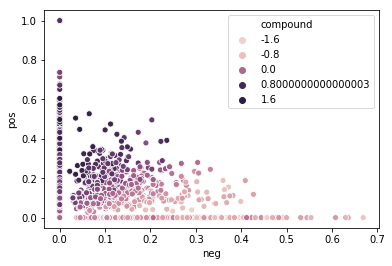

In [13]:
sns.scatterplot(x='neg',y='pos',hue='compound', data=pol_scores_df);

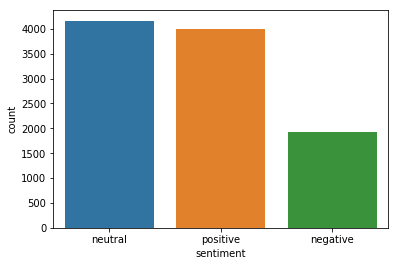

In [14]:
sns.countplot(x='sentiment', data=labeled_train_nfl_df);

In [15]:
logger.info(f'Negative Count: {len(labeled_train_nfl_df[labeled_train_nfl_df["sentiment"] == "negative"])}')
logger.info(f'Positive Count: {len(labeled_train_nfl_df[labeled_train_nfl_df["sentiment"] == "positive"])}')
logger.info(f'Neutral Count: {len(labeled_train_nfl_df[labeled_train_nfl_df["sentiment"] == "neutral"])}')

neg_count = len(labeled_train_nfl_df[labeled_train_nfl_df["sentiment"] == "negative"])
pos_count = len(labeled_train_nfl_df[labeled_train_nfl_df["sentiment"] == "positive"])

print(neg_count/pos_count)
print(pos_count/neg_count)   

Negative Count: 1935
Positive Count: 3991
Neutral Count: 4164


0.4848408920070158
2.0625322997416022


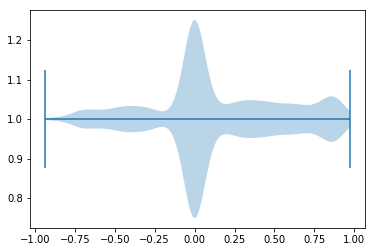

In [16]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['compound'], vert=False)

# Show the plot
plt.show()

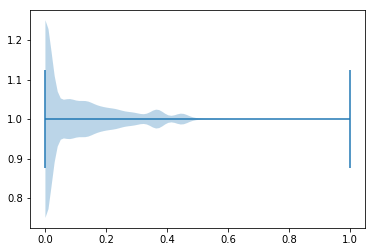

In [17]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['pos'], vert=False)

# Show the plot
plt.show()

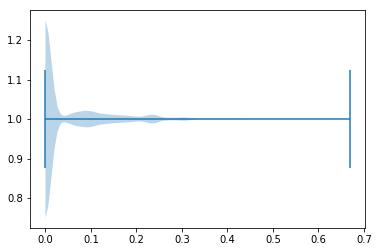

In [18]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['neg'], vert=False)

# Show the plot
plt.show()

## 1.2 Sentiment Classification - Cleansed Tweet Text

In [43]:
custom_stop_words=['RT','rt','deshaun', 'watson','bill', 'obrian','houston', 'texans','nfl']

In [44]:
# create new data frame to hold cleaned text
train_nfl_master_clean_df = pd.DataFrame()
train_nfl_master_clean_df['id'] = train_nfl_master['id']
train_nfl_master_clean_df['text'] = train_nfl_master['text']
train_nfl_master_clean_df['text_clean'] = [br.clean_text(logger, t, custom_stop_words) for t in train_nfl_master['text']]

In [42]:
logger.info(f'{train_nfl_master_clean_df.shape}')
train_nfl_master_clean_df.head()

(10148, 3)


,id,text,text_clean
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...,recent calculated valuations patrick mahomes d...
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...,last six qbs face patriots defense ryan fitzpa...
2,1170439772814422016,I got Lj and deshaun watson.... I been think...,got thinking starting especially baltimoreã¢ââ¦
3,1172871878538596352,RT How do I inquire about a trade with the Tex...,inquire trade texas would like put vic beasley...
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...,knew first nfl paycheck hit bank account team ...


In [46]:
analyzer = SentimentIntensityAnalyzer()
pol_scores=[]
pol_text=[]
pol_text_clean=[]
pol_text_id=[]

with io.open(f'{outputDir}/vader_tweet_sentiment_cleaned.txt','w+',encoding='latin') as f:
    for index, row in train_nfl_master_clean_df.iterrows():
        try:
            vs = analyzer.polarity_scores(row['text_clean'])
            pol_scores.append(vs)
            pol_text_clean.append(row['text_clean'])
            pol_text.append(row['text'])
            pol_text_id.append(row['id'])
            f.write("{:-<65} {}".format(row['text_clean'], str(vs))+'\n')
            logger.debug("{:-<65} {}".format(row['text_clean'], str(vs)))
        
        except BaseException as be:
            logger.warning(f'***WARNING***: SentimentIntensityAnalyzer --- Caught Exception: {be}')

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 79: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 83: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(r

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 65: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 67: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 68: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python3

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\io

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 121: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 49: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 91: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 116: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 42: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 122: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 171: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 171: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 103: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\to

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 63: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code


  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x82' in position 55: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 43: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 124: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 54: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 93: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 75: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 95: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 88: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", li

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 67: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 131: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x81' in position 69: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 41: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 92: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 116: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs)))
Message: "tell mcnair taught everything know canã¢â\x80â\x99t wait induct man brought football back ring honor wearetexans {'neg': 0.0, 'neu': 0.814

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 86: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 106: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 58: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 40: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 132: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 136: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    in

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  Fil

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 123: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._callback, *self._args)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 690, in <lambda>
    lambda f: self._run_callback(functools.partial(callback, future))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\ioloop.py", line 743, in _run_callback
    ret = callback()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 787, in inner
    self.run()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 748, in run
    yielded = self.gen.send(value)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 365, in process_one
    yield gen.maybe_future(dispatch(*args))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
 

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 44: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 118: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 51: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x9f' in position 49: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 121: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs)))
Message: "new chronicle watsonã¢â\x80â\x99s style play fast think fast----------- {'neg': 0.0, 'neu': 0.745, 'pos': 0.255, 'compound': 0.34}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-package

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 272, in dispatch_shell
    yield gen.maybe_future(handler(stream, idents, msg))
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelbase.py", line 542, in execute_request
    user_expressions, allow_stdin,
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\gen.py", line 209, in wrapper
    yielded = next(result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\ipkernel.py", line 294, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 55: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 96: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 66: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x87' in position 179: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 120: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 102: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykerne

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 115: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\zmqshell.py", line 536, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2855, in run_cell
    raw_cell, store_history, silent, shell_futures)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x83' in position 86: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 81: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\s

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\Ap

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 2881, in _run_cell
    return runner(coro)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py", line 68, in _pseudo_sync_runner
    coro.send(None)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3058, in run_cell_async
    interactivity=interactivity, compiler=compiler, result=result)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3249, in run_ast_nodes
    if (await self.run_code(code, result,  async_=asy)):
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs

--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 103: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()
  File "C:\ProgramData\Anaconda3\lib\asyncio\events.py", line 88, in _run
    self._context.run(self._call

  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\traitlets\config\application.py", line 658, in launch_instance
    app.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\ipykernel\kernelapp.py", line 563, in start
    self.io_loop.start()
  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\tornado\platform\asyncio.py", line 148, in start
    self.asyncio_loop.run_forever()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 539, in run_forever
    self._run_once()
  File "C:\ProgramData\Anaconda3\lib\asyncio\base_events.py", line 1775, in _run_once
    handle._run()

  File "C:\Users\rt310\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py", line 3326, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-46-902536babcd5>", line 16, in <module>
    logger.debug("{:-<65} {}".format(row['text_clean'], str(vs)))
Message: "ownership asleep wheel letting coach obrien make headscratching tradesã¢â\x80â¦ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}"
Arguments: ()
--- Logging error ---
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\logging\__init__.py", line 1037, in emit
    stream.write(msg + self.terminator)
  File "C:\ProgramData\Anaconda3\lib\encodings\cp1252.py", line 19, in encode
    return codecs.charmap_encode(input,self.errors,encoding_table)[0]
UnicodeEncodeError: 'charmap' codec can't encode character '\x80' in position 60: character maps to <undefined>
Call stack:
  File "C:\ProgramData\Anaconda3\lib\runpy.py", line 193, in _run_module_as_main
   

In [47]:
# evaluate the polarity scoring
labeled_train_nfl_clean_df = pd.DataFrame()
labeled_train_nfl_clean_df['id'] = pol_text_id
labeled_train_nfl_clean_df['text'] = pol_text
labeled_train_nfl_clean_df['text_clean'] = pol_text_clean
labeled_train_nfl_clean_df['scores'] = pol_scores

logger.info(f'labeled_train_nfl_clean_df.shape: {labeled_train_nfl_clean_df.shape}')
labeled_train_nfl_clean_df.head()

labeled_train_nfl_clean_df.shape: (10148, 4)


,id,text,text_clean,scores
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...,recent calculated valuations patrick mahomes d...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...,last six qbs face patriots defense ryan fitzpa...,"{'neg': 0.0, 'neu': 0.914, 'pos': 0.086, 'comp..."
2,1170439772814422016,I got Lj and deshaun watson.... I been think...,got thinking starting especially baltimoreã¢ââ¦,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
3,1172871878538596352,RT How do I inquire about a trade with the Tex...,inquire trade texas would like put vic beasley...,"{'neg': 0.0, 'neu': 0.783, 'pos': 0.217, 'comp..."
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...,knew first paycheck hit bank account team prac...,"{'neg': 0.138, 'neu': 0.862, 'pos': 0.0, 'comp..."


In [49]:
# evaluate the polarity scoring
pol_scores_df = pd.DataFrame(pol_scores)
logger.info(pol_scores_df.describe())
#pol_scores_df.head()

# classify each sentence as 'positive', 'negative' or 'neutral' - see function above
sentiment_classes = [classify_vader_score_threshold(c) for c in pol_scores_df['compound'] ]
labeled_train_nfl_clean_df['sentiment'] = sentiment_classes
labeled_train_nfl_clean_df.head()

           compound           neg           neu           pos
count  10148.000000  10148.000000  10148.000000  10148.000000
mean       0.131509      0.062483      0.776505      0.149950
std        0.391850      0.126900      0.239372      0.199071
min       -0.933700      0.000000      0.000000      0.000000
25%        0.000000      0.000000      0.603000      0.000000
50%        0.000000      0.000000      0.826000      0.000000
75%        0.421500      0.054000      1.000000      0.286000
max        0.970500      1.000000      1.000000      1.000000


,id,text,text_clean,scores,sentiment
0,1172854321421201409,Recent Calculated Valuations Patrick Mahomes ...,recent calculated valuations patrick mahomes d...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",neutral
1,1187876924292583424,Last six QBs to face the Patriots defense: Ry...,last six qbs face patriots defense ryan fitzpa...,"{'neg': 0.0, 'neu': 0.914, 'pos': 0.086, 'comp...",positive
2,1170439772814422016,I got Lj and deshaun watson.... I been think...,got thinking starting especially baltimoreã¢ââ¦,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",neutral
3,1172871878538596352,RT How do I inquire about a trade with the Tex...,inquire trade texas would like put vic beasley...,"{'neg': 0.0, 'neu': 0.783, 'pos': 0.217, 'comp...",positive
4,1198385118034956288,Deshaun Watson knew his first NFL paycheck hit...,knew first paycheck hit bank account team prac...,"{'neg': 0.138, 'neu': 0.862, 'pos': 0.0, 'comp...",negative


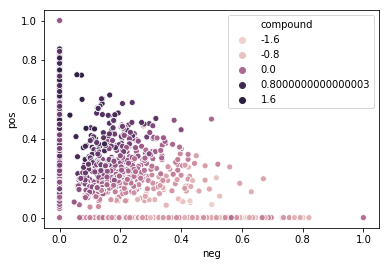

In [50]:
sns.scatterplot(x='neg',y='pos',hue='compound',  data=pol_scores_df);

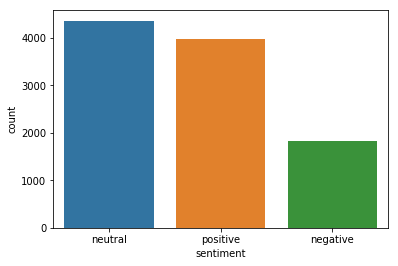

In [51]:
sns.countplot(x='sentiment', data=labeled_train_nfl_clean_df);

In [52]:
logger.info(f'Negative Count: {len(labeled_train_nfl_clean_df[labeled_train_nfl_clean_df["sentiment"] == "negative"])}')
logger.info(f'Positive Count: {len(labeled_train_nfl_clean_df[labeled_train_nfl_clean_df["sentiment"] == "positive"])}')
logger.info(f'Neutral Count: {len(labeled_train_nfl_clean_df[labeled_train_nfl_clean_df["sentiment"] == "neutral"])}')

neg_count = len(labeled_train_nfl_clean_df[labeled_train_nfl_clean_df["sentiment"] == "negative"])
pos_count = len(labeled_train_nfl_clean_df[labeled_train_nfl_clean_df["sentiment"] == "positive"])

print(neg_count/pos_count)
print(pos_count/neg_count)

Negative Count: 1819
Positive Count: 3972
Neutral Count: 4357


0.45795568982880164
2.183617372182518


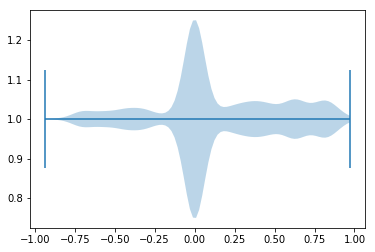

In [53]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['compound'], vert=False)

# Show the plot
plt.show()

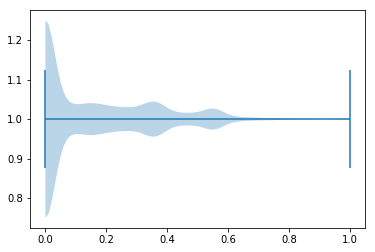

In [54]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['pos'], vert=False)

# Show the plot
plt.show()

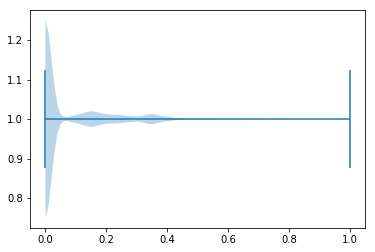

In [55]:
# Initialize Figure and Axes object
fig, ax = plt.subplots()
# Create violinplot
ax.violinplot(pol_scores_df['neg'], vert=False)

# Show the plot
plt.show()

## Write New Training Data Set to File

In [56]:
labeled_train_nfl_df.to_csv(f'{dataDir}/sentiment_labeled_train_nfl.csv', index=False)
labeled_train_nfl_clean_df.to_csv(f'{dataDir}/sentiment_labeled_train_nfl_clean.csv', index=False)

## 2. Merge Training Data Sets - Create one Master file
* train_tweets_master.csv ---- this data set lowered our sentiment classification accuracy by 15% -- removing from experiments
    * Airline
    * GOP 
* sentiment_labeled_train_nfl_clean.csv

Primary Training Data Set Name:
* train_tweets_combined_master_clean.csv


In [35]:
# this dataset is just the airline and gop tweets ---- removing from this test
#train_tweets_master = pd.read_csv(f'{dataDir}/train_tweets_master.csv', encoding='latin')

#logger.info(f'{train_tweets_master.shape}')
#train_tweets_master.head()

(28511, 5)


,id,sentiment,sentiment_confidence,text,df_label
0,5.703061e+17,neutral,1.0000,@VirginAmerica What @dhepburn said.,airline
1,5.703011e+17,positive,0.3486,@VirginAmerica plus you've added commercials t...,airline
2,5.703011e+17,neutral,0.6837,@VirginAmerica I didn't today... Must mean I n...,airline
3,5.703010e+17,negative,1.0000,@VirginAmerica it's really aggressive to blast...,airline
4,5.703008e+17,negative,1.0000,@VirginAmerica and it's a really big bad thing...,airline


In [36]:
#np.unique(train_tweets_master['df_label'])

array(['airline', 'gop'], dtype=object)

In [ ]:
#train_tweets_master_clean_df = pd.DataFrame()
#train_tweets_master_clean_df['id'] = train_tweets_master['id']
#train_tweets_master_clean_df['df_label'] = train_tweets_master['df_label']
#train_tweets_master_clean_df['sentiment'] = train_tweets_master['sentiment']
#train_tweets_master_clean_df['text'] = [br.clean_text(logger, t) for t in train_tweets_master['text']]
#logger.info(f'train_tweets_master_clean_df.shape: {train_tweets_master_clean_df.shape}')

In [37]:
#df_labels = []
#for i in range(0,labeled_train_nfl_clean_df.shape[0]):
   # df_labels.append('nfl')
#logger.info(f'len(df_labels): {len(df_labels)}')

len(df_labels): 10148


In [ ]:
#train_tweets_master_nfl_df = pd.DataFrame()
#train_tweets_master_nfl_df['id'] = labeled_train_nfl_clean_df['id']
#train_tweets_master_nfl_df['df_label'] = df_labels
#train_tweets_master_nfl_df['sentiment'] = labeled_train_nfl_clean_df['sentiment']
#train_tweets_master_nfl_df['text'] = labeled_train_nfl_clean_df['text']

#logger.info(f'train_tweets_master_nfl_df.shape: {train_tweets_master_nfl_df.shape}')


In [ ]:
#train_tweets_combined_clean_df = pd.DataFrame()

#train_tweets_combined_clean_df = train_tweets_combined_clean_df.append(train_tweets_master_clean_df, ignore_index=True)
#train_tweets_combined_clean_df = train_tweets_combined_clean_df.append(train_tweets_master_nfl_df, ignore_index=True)

#logger.info(f'train_tweets_combined_clean_df.shape: {train_tweets_combined_clean_df.shape}')

In [ ]:
#train_tweets_combined_clean_df.to_csv(f'{dataDir}/train_tweets_combined_master_clean.csv', index=False)